* Plot the spatial salinity pattern at peak ebbs with and without Coriolis force.

In [1]:
import numpy as np
import netCDF4 as nc
from salishsea_tools import (nc_tools,viz_tools,tidetools,geo_tools)
import matplotlib.pyplot as plt
import StraTimeSeries as sts
import R_mixStuff as RS
import warnings
warnings.filterwarnings("ignore")
import seaborn as sns
sns.set(style="whitegrid")
sns.set_context("notebook", font_scale=2., rc={"lines.linewidth": 2.5})
%matplotlib inline

In [2]:
grid6 = nc.Dataset('/ocean/jieliu/research/meopar/river-treatment/bathy_meter_SalishSea6.nc')
X = grid6.variables['nav_lon'][:, :]
Y = grid6.variables['nav_lat'][:, :]
bathy = grid6.variables['Bathymetry'][:, :]
## tmask
mesh = nc.Dataset('/data/jieliu/MEOPAR/river-treatment/oct8_101e061e05/mesh_mask.nc')
tmask = mesh.variables['tmask'][0,:,380:510,240:397]
np_mask = np.abs(1-tmask) 
e3t = mesh.variables['e3t'][0,:,380:510,240:397]

In [3]:
## load grid_T model results
octall_T = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Oct2014combineall/oct2014all_T.nc')
mayall_T = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/May2015combineall/may2015all_T.nc')
janall_T = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Jan2016combineall/jan2016all_T.nc')

octnof_T = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Oct2014nof/oct2014nof_T.nc')
maynof_T = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/May2015nof/may2015nof_T.nc')
jannof_T = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Jan2016nof/jan2016nof_T.nc')

In [4]:
## load grid_U model results
octall_U = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Oct2014combineall/oct2014all_U.nc')
mayall_U = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/May2015combineall/may2015all_U.nc')
janall_U = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Jan2016combineall/jan2016all_U.nc')

octnof_U = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Oct2014nof/oct2014nof_U.nc')
maynof_U = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/May2015nof/may2015nof_U.nc')
jannof_U = nc.Dataset('/data/jieliu/MEOPAR/SurfaceCurrent/Jan2016nof/jan2016nof_U.nc')

In [5]:
def determine_plume_method2_onlysalinity(grid_T,tst,ted,dep_ind):
    """Similar to method1, but this time the S_ref is the spatial mean 
    of the 2.5*2.5 km in the northern of my subdomain and not plot them, only get the
    threshold salinity"""
    S = grid_T.variables['vosaline']
    lon = grid_T.variables['nav_lon']
    lat = grid_T.variables['nav_lat']
    S_aveN = np.nanmean(S[tst:ted,:,-5:,0:5],axis = 0) ## first temporal average of northern region
    S_ref = np.nanmean(S_aveN[dep_ind]) ## then spatial average
    S_thre = 1.14*S_ref-4.8
    S_aveW = np.nanmean(S[tst:ted,dep_ind],axis = 0) ## temporal averaged of the whole domain
    S_aveW = np.ma.masked_values(S_aveW, 0) ## mask 0 value
    return S_thre, S_aveW

In [15]:
def Salinity(grid_T1,grid_T2,t1,t2,colormap,dep,cmin = -6,cmax = 6,ave = False):
    """Quiver velocity on top of surface salinity"""
    fig,axs = plt.subplots(1,3,figsize=(20,6))
    theta = np.pi*29/180
    S = {};U = {};V= {}
    for gridT,run, ax in zip([grid_T1,grid_T2],['all','nof'],[axs[0],axs[1]]):
        lon = gridT.variables['nav_lon']
        lat = gridT.variables['nav_lat']
        if ave ==False:
            S[run] =gridT.variables['vosaline'][t1,0]
            S[run] = np.ma.masked_values(S[run],0)
        else:
            S[run] =np.ma.masked_values(np.nanmean(gridT.variables['vosaline'][t1:t2+1,0],axis = 0),0)
            
        mesh=ax.pcolormesh(lon,lat,S[run],vmin =0,vmax = 33,cmap=colormap) 
        cbar = fig.colorbar(mesh,ax = ax)
        cbar.set_label('Practical Salinity')
        if ave == False:
            S_thre,W = determine_plume_method2_onlysalinity(gridT,t1,t1+1,dep)
        else:
            S_thre,W = determine_plume_method2_onlysalinity(gridT,t1,t2+1,dep)
        if grid_T1 == mayall_T:
            S_thre = 18.3
        if grid_T1 == octall_T:
            S_thre = 25.3
        if grid_T1 == janall_T:
            S_thre = 24.7
        CS3 = ax.contour(lon[:],lat[:],W, levels = [S_thre], colors='k',linewidths=(3,))
        plt.clabel(CS3,fmt='%2.1f', colors='k',fontsize = 14)
        viz_tools.plot_land_mask(ax,grid6,coords='map',color='burlywood')
        viz_tools.plot_coastline(ax, grid6, coords = 'map')
        ax.set_xlim([-124.,-122.8])
        ax.set_xticks([-124,-123.6,-123.2,-122.8])
        ax.set_xticklabels([-124,-123.6,-123.2,-122.8])
        ax.set_ylim([48.9,49.5])
        ## add minimum salinity plot if available
    sal_diff = S['all'] - S['nof']
    ax = axs[2]
    mesh=ax.pcolormesh(lon,lat,sal_diff,cmap='RdBu_r',vmin=cmin, vmax=cmax)
    cbar = fig.colorbar(mesh,ax = ax)
    cbar.set_label('Difference of Practical Salinity')
    SS,W = determine_plume_method2_onlysalinity(grid_T1,t1,t2+1,dep)
    CS3 = ax.contour(lon[:],lat[:],W, levels = [S_thre], colors='k',linewidths=(3,))
    plt.clabel(CS3,fmt='%2.1f', colors='k',fontsize = 14)
    viz_tools.plot_land_mask(ax,grid6,coords='map',color='burlywood')
    viz_tools.plot_coastline(ax, grid6, coords = 'map')
    ax.set_xlim([-124.,-122.8])
    ax.set_xticks([-124,-123.6,-123.2,-122.8])
    ax.set_xticklabels([-124,-123.6,-123.2,-122.8])
    ax.set_ylim([48.9,49.5])

In [7]:
U = {}
for month,gridU in zip(['jan','oct','may'],[janall_U,octall_U,mayall_U]):
    U[month] = gridU.variables['vozocrtx']
SSH = {}
for month,gridT in zip(['jan','oct','may'],[janall_T,octall_T,mayall_T]):
    SSH[month] = gridT.variables['sossheig']

In [8]:
theta = np.pi*29/180
grid_T_alls = [janall_T,octall_T,mayall_T]
grid_T_nofs = [jannof_T,octnof_T,maynof_T]
S_thres = [24.7, 25.3, 18.3]
colormap = 'plasma_r'
dep = 0
cmin = -6
cmax = 6

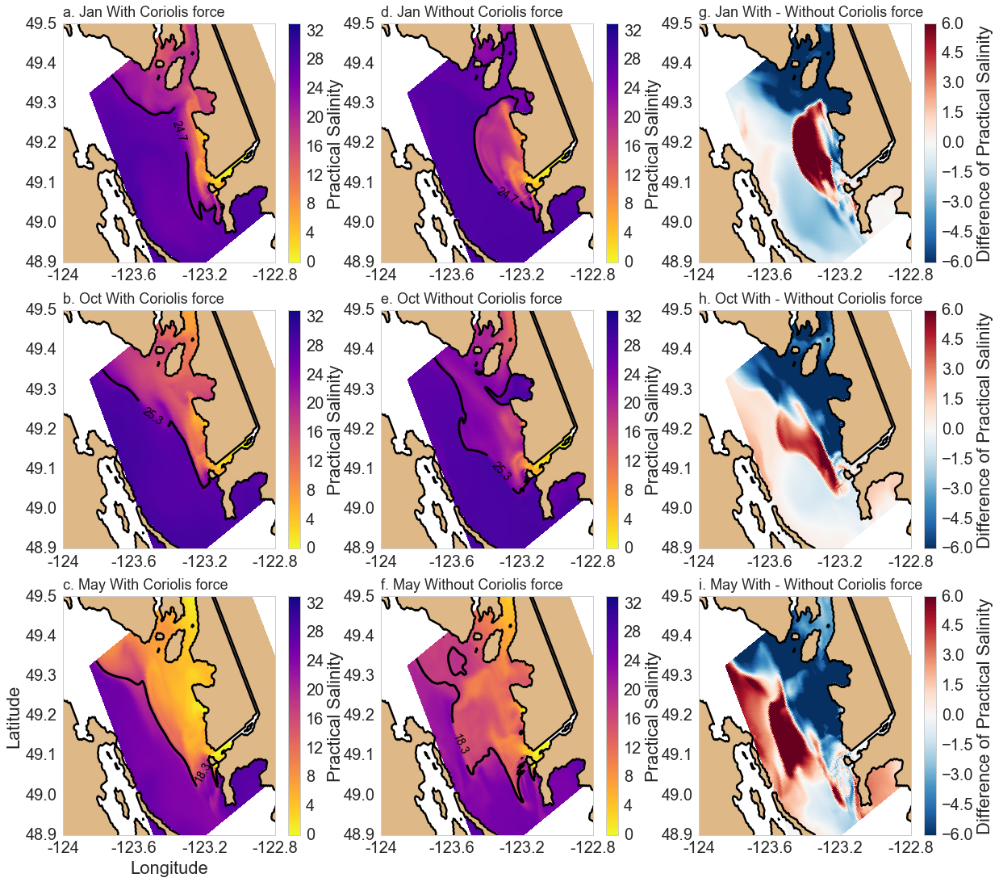

In [14]:
fig,axs = plt.subplots(3,3,figsize=(20,18))
    
for i, t1 in zip(np.arange(3), [679,432,350]):
    S = {};
    if i == 0:
        letters = ['a. Jan With Coriolis force', 'd. Jan Without Coriolis force', 'g. Jan With - Without Coriolis force']
    elif i ==1:
        letters = ['b. Oct With Coriolis force', 'e. Oct Without Coriolis force', 'h. Oct With - Without Coriolis force']
    elif i ==2:
        letters = ['c. May With Coriolis force', 'f. May Without Coriolis force', 'i. May With - Without Coriolis force']
    for gridT,run, ax,letter,S_thre in zip([grid_T_alls[i],grid_T_nofs[i]],['all','nof'],[axs[i,0],axs[i,1]],\
                                           letters, [S_thres[i],S_thres[i]]):
        lon = gridT.variables['nav_lon']
        lat = gridT.variables['nav_lat']
        S[run] =gridT.variables['vosaline'][t1,0]
        S[run] = np.ma.masked_values(S[run],0) 
        mesh=ax.pcolormesh(lon,lat,S[run],vmin =0,vmax = 33,cmap=colormap) 
        ax.text(0,1.03,letter, transform = ax.transAxes,fontsize = 18)
        cbar = fig.colorbar(mesh,ax = ax)
        cbar.set_label('Practical Salinity')
        #S_thre,W = determine_plume_method2_onlysalinity(gridT,t1,t1+1,dep)
        CS3 = ax.contour(lon[:],lat[:],S[run], levels = [S_thre], colors='k',linewidths=(3,))
        plt.clabel(CS3,fmt='%2.1f', colors='k',fontsize = 14)
        if letter == 'c. May With Coriolis force':
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')
    sal_diff = S['all'] - S['nof']
    ax = axs[i,2]
    mesh=ax.pcolormesh(lon,lat,sal_diff,cmap='RdBu_r',vmin=cmin, vmax=cmax)
    ax.text(0,1.03,letters[-1], transform = ax.transAxes,fontsize = 18)
    cbar = fig.colorbar(mesh,ax = ax)
    cbar.set_label('Difference of Practical Salinity')
    for ax in [axs[i,0],axs[i,1],axs[i,2]]:
        viz_tools.plot_land_mask(ax,grid6,coords='map',color='burlywood')
        viz_tools.plot_coastline(ax, grid6, coords = 'map')
        ax.set_xlim([-124.,-122.8])
        ax.set_xticks([-124,-123.6,-123.2,-122.8])
        ax.set_xticklabels([-124,-123.6,-123.2,-122.8])
        ax.set_ylim([48.9,49.5])

In [19]:
PEC = {} ## short form of peak ebb currents!
PET = {}## short form of peak ebb times!
for month in ['jan','oct','may']:
    PEC[month] = [];
    PET[month] = [];
    
for month in ['jan','oct','may']:
    for t in np.arange(0,len(U[month]),24):
        pec = np.nanmin(U[month][t:t+24,0,38,72])
        PEC[month].append(pec)
        pet = np.nanargmin(U[month][t:t+24,0,38,72])+t
        PET[month].append(pet)

In [20]:
import wind
def get_OPwinds(stationsOP,OPlon,OPlat,filesOP,j,i,duration,sax,eax):
    "This function was made to get model winds' speed and direction"
    wind_speed = {}; wind_dir = {}; time = {}; lat={}; lon={}; press={}; temp={}; therm={};
    solar={}; precip={}; qair={}; lon = {};lat = {};

    for  modOP in stationsOP:   
        
        [j,i]=wind.find_model_point(X[j,i],Y[j,i],OPlon,OPlat)
        lon[modOP] = OPlon[j,i]
        lat[modOP]=OPlat[j,i]
        print(j,i,lon[modOP],lat[modOP])

        [wind_speed[modOP],wind_dir[modOP],time[modOP],
         press[modOP],temp[modOP],solar[modOP],
         therm[modOP],qair[modOP],precip[modOP]] = wind.compile_OP(filesOP,j,i)    
      
    return wind_speed, wind_dir

In [21]:
import glob
import os
import datetime

OP = nc.Dataset('/results/forcing/atmospheric/GEM2.5/operational/ops_y2015m05d01.nc')
OPlon =OP.variables['nav_lon'][:]-360
OPlat = OP.variables['nav_lat'][:]

filesOP = glob.glob('/results/forcing/atmospheric/GEM2.5/operational/ops_y2015m05d*.nc')
filesOP.sort(key=os.path.basename)
start = '1-May-2015'; end = '31-May-2015';
start2 = '31-May-2015'; end2 = '31-May-2015';
endd = '31-May-2015';
stations = ['Sandheads']; stationsOP =['Sandheads_OP'];
sax=datetime.datetime.strptime(start,'%d-%b-%Y')
eax=datetime.datetime.strptime(endd,'%d-%b-%Y')

wind_speedMay,wind_dirMay =get_OPwinds(stationsOP,OPlon,OPlat,filesOP,426,293,\
                       27,sax,eax)

135 151 -123.302707487 49.0907848354


In [22]:
## May
import pandas as pd
wind_dir_correctMay = []
for dire in wind_dirMay['Sandheads_OP']:
    dire_corre = 450 - dire
    wind_dir_correctMay.append(dire_corre)
df_may = pd.DataFrame({"speed": wind_speedMay['Sandheads_OP'], "direction": wind_dir_correctMay})

u_may = np.zeros([1,len(df_may)])
v_may = np.zeros([1,len(df_may)])
for i in np.arange(len(df_may)):
    u_may[0,i] = df_may.speed[i] * np.cos((450-df_may.direction[i])*np.pi/180)
    v_may[0,i] = df_may.speed[i] * np.sin((450-df_may.direction[i])*np.pi/180)

# Check Wind

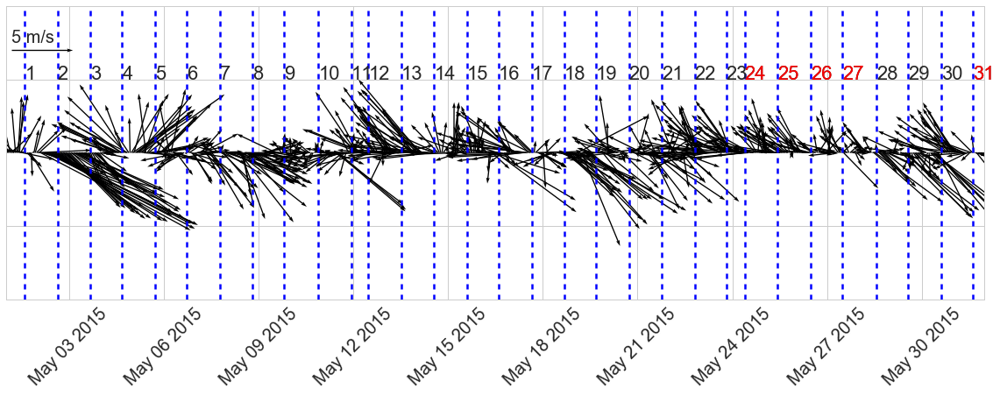

In [23]:
t_wind = [datetime.datetime(2015,5,d,h,30) for d in np.arange(1,32,1) for h in np.arange(0,24)]
t_start = datetime.datetime(2015,5,1,0,30)
t_end = datetime.datetime(2015,5,31,23,30)

import matplotlib.dates as md
fig, ax = plt.subplots(1,1,figsize = (20,6))
quiver = ax.quiver(md.date2num(t_wind),np.ones(1),u_may[:],v_may[:],scale = 80,width=0.0012, color='k') 
ax.quiverkey(quiver,md.date2num(t_wind)[4],1.7, 5, '',coordinates='data', color='black', labelcolor='black')
ax.set_xlim([t_start,t_end])
ax.text(md.date2num(t_wind)[4],1.75,'5 m/s', fontsize = 20)
plt.setp(ax.get_yticklabels(), visible=False)
i = 1
for t in PET['may']:
    ax.plot([t_wind[t],t_wind[t]],[0,2.],'b--')
    ax.text(t_wind[t],1.5, str(i),fontsize = 22)
    if i == 24 or i ==25 or i ==26 or i== 27 or i== 31:
        ax.text(t_wind[t],1.5, str(i),fontsize = 22,color = 'r')   
    i+=1
plt.xticks(rotation=45)
plt.show()

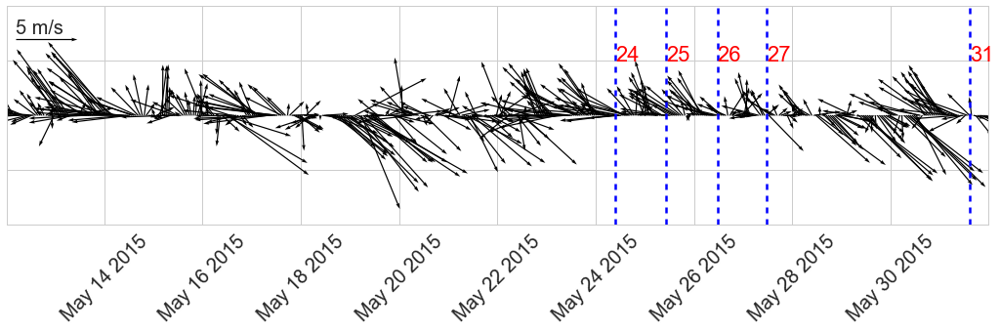

In [25]:
fig, ax= plt.subplots(1,1,figsize = (18,4))
t_start_zoomin = datetime.datetime(2015,5,12,0,30)
t_end_zoomin = datetime.datetime(2015,5,31,23,30)
t_wind_zoomin = [datetime.datetime(2015,5,d,h,30) for d in np.arange(12,32,1) for h in np.arange(0,24)]
quiver = ax.quiver(md.date2num(t_wind_zoomin),np.ones(1),u_may[0,24*11:],v_may[0,24*11:],scale = 80,width=0.0012, color='k') 
ax.set_xlim([t_start_zoomin,t_end_zoomin])
ax.quiverkey(quiver,md.date2num(t_wind_zoomin)[4],1.7, 5, '',coordinates='data', color='black', labelcolor='black')
ax.text(md.date2num(t_wind_zoomin)[4],1.75,'5 m/s', fontsize = 20)
for t, i in zip([561,586,611,635,734],\
                [24,25,26,27,31]):
    ax.plot([t_wind[t],t_wind[t]],[0,2.],'b--')
    ax.text(t_wind[t],1.5, str(i),fontsize = 22,color = 'r')

plt.xticks(rotation=45)
plt.setp(ax.get_yticklabels(), visible=False)
plt.show()

# Plot

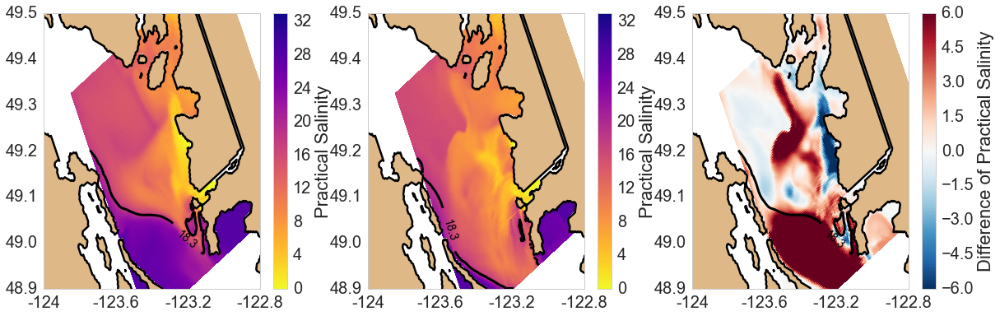

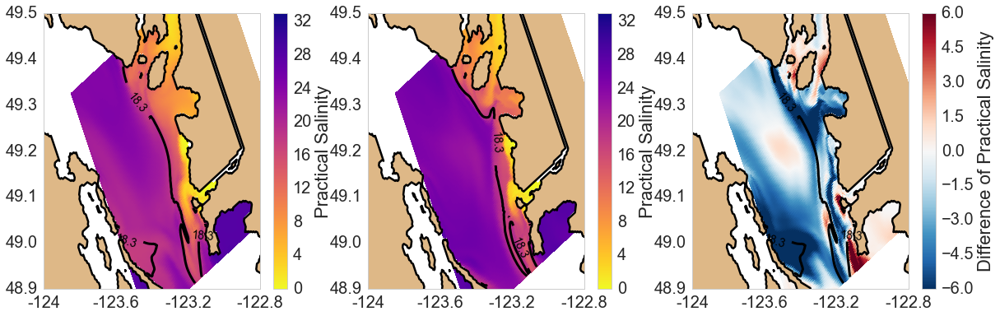

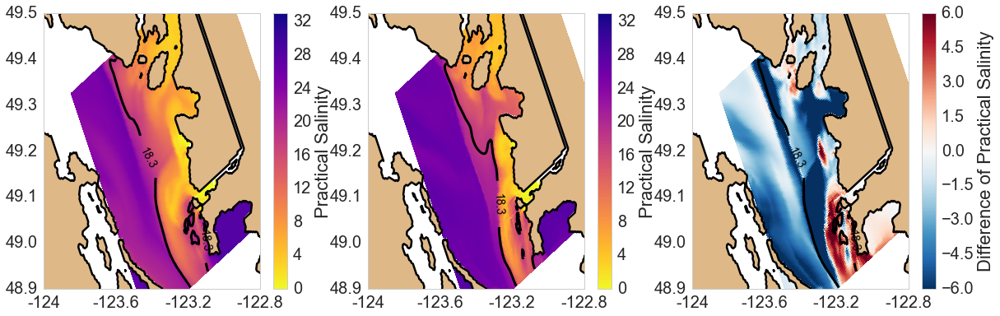

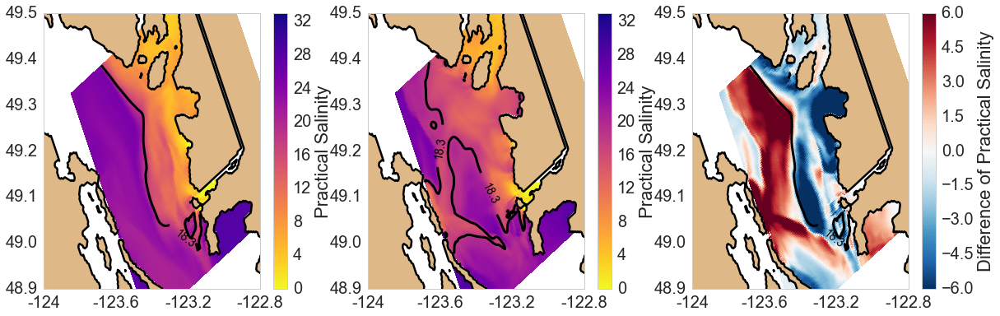

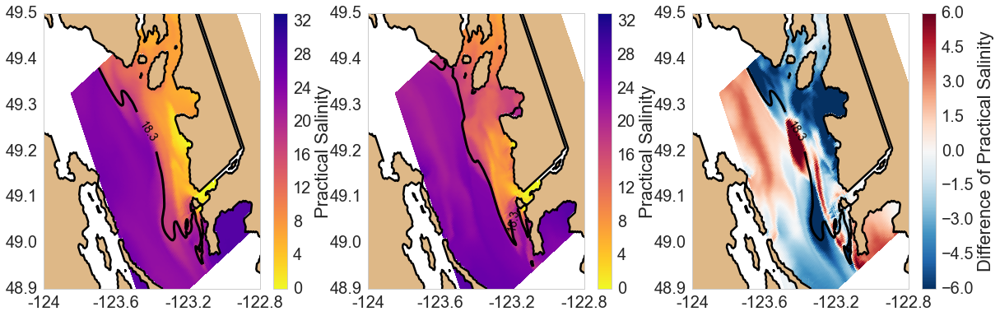

...

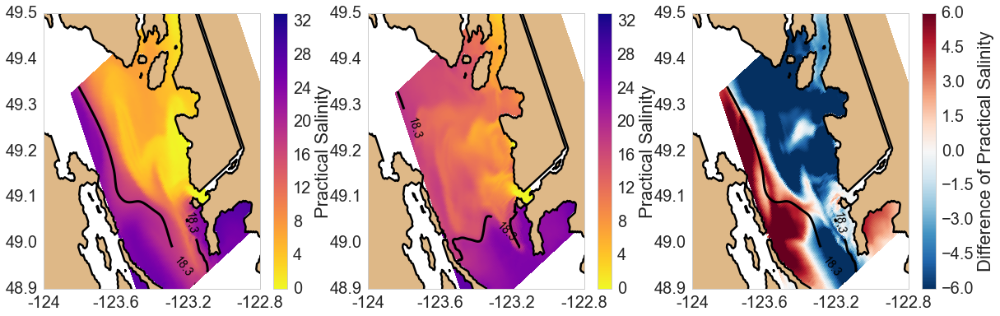

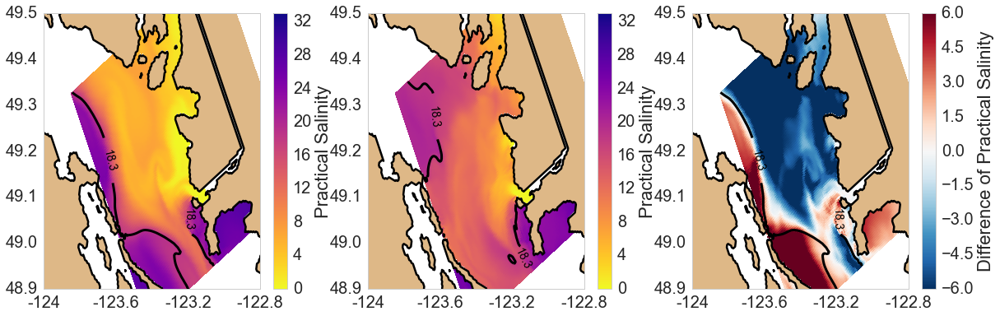

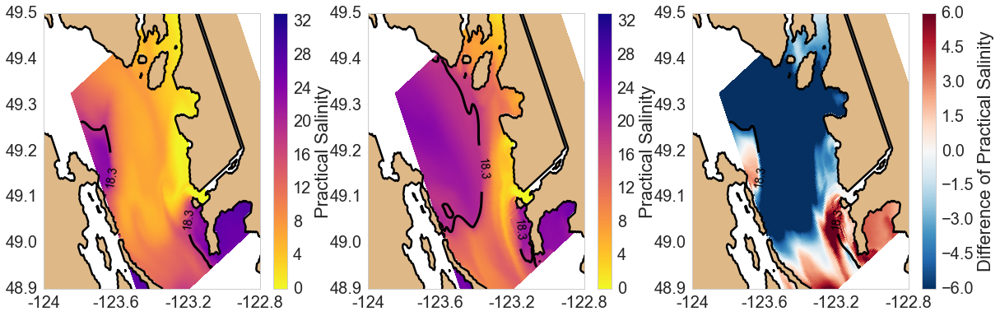

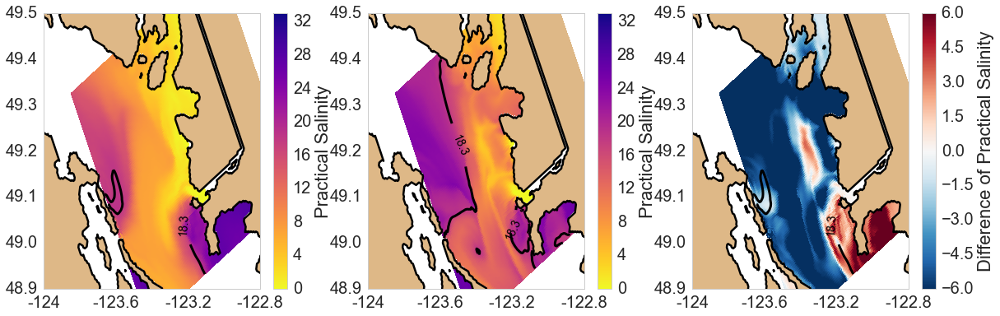

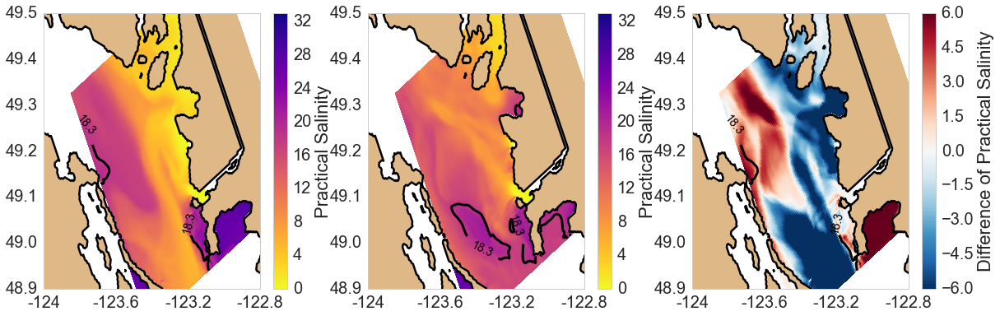

In [17]:
## May
for t in PET['may']:
    Salinity(mayall_T,maynof_T,t,t,'plasma_r',0)

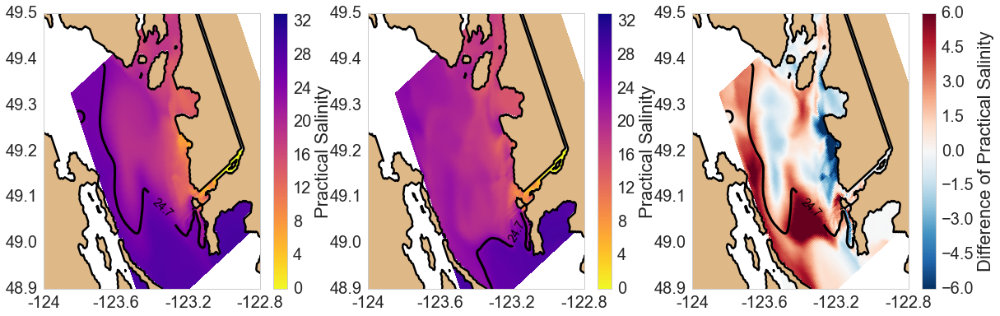

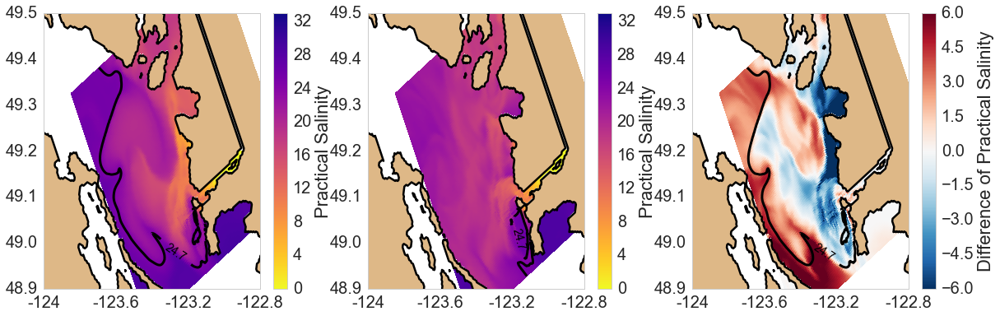

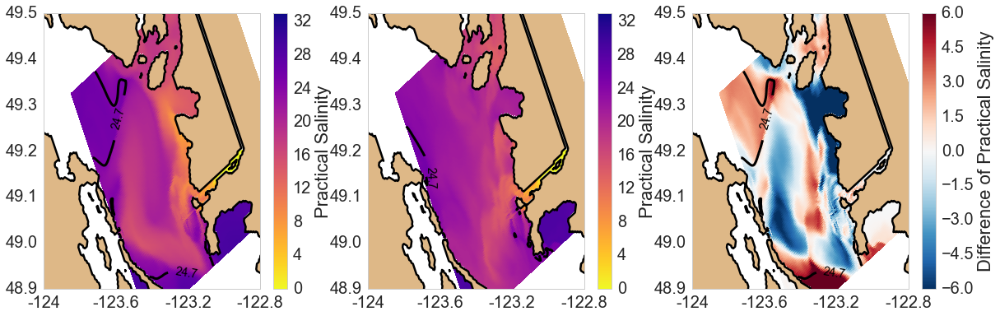

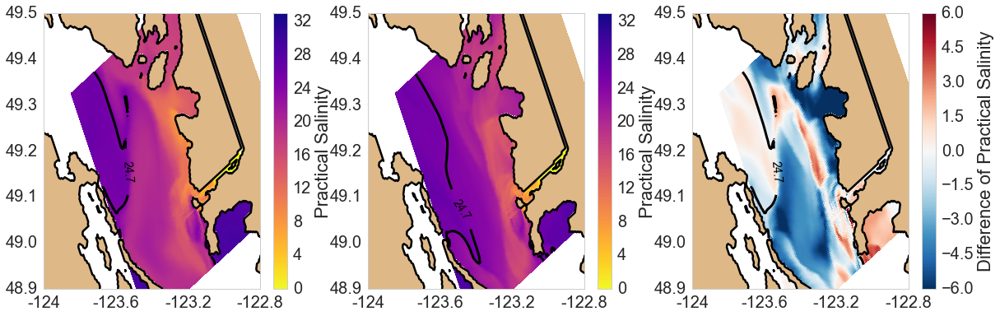

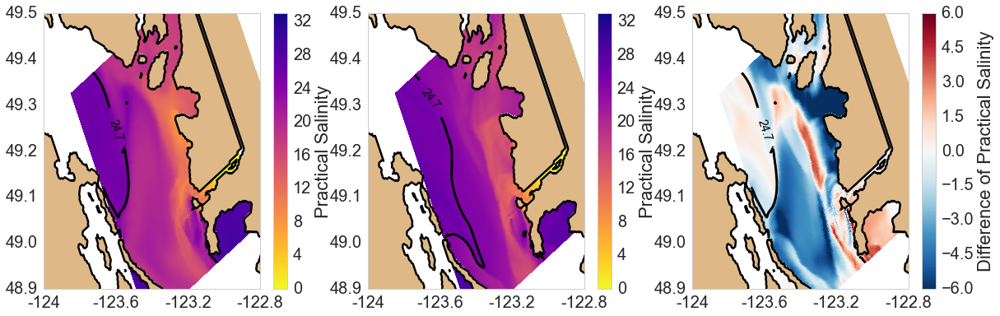

...

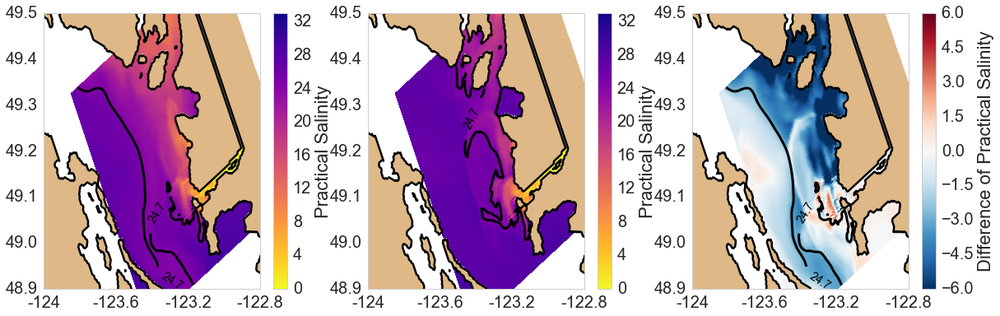

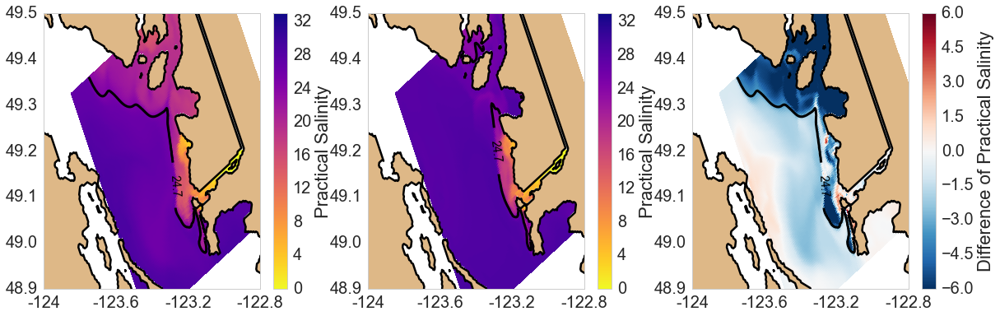

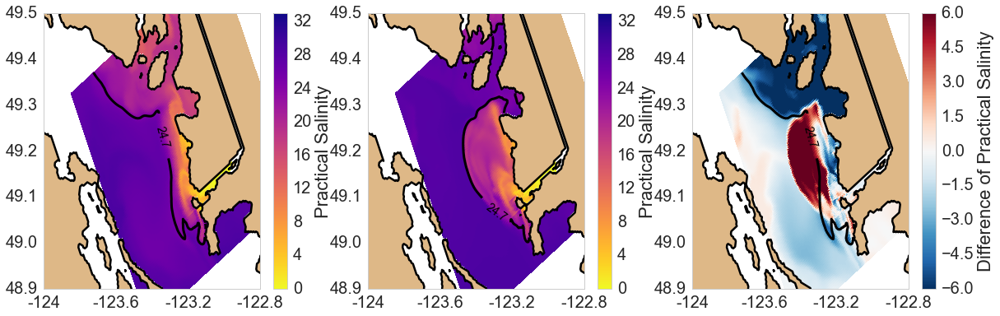

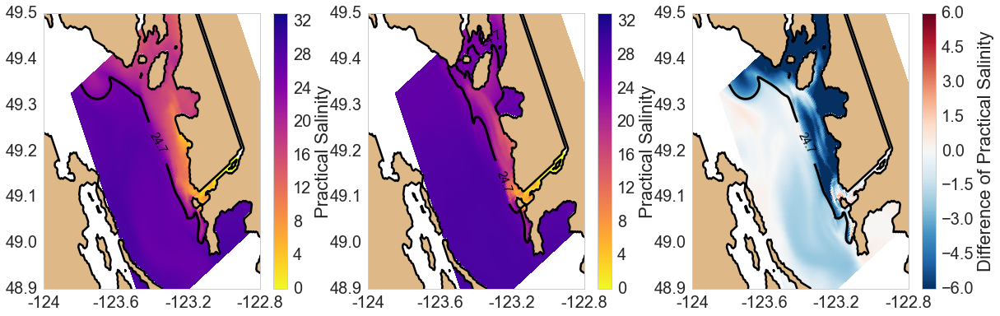

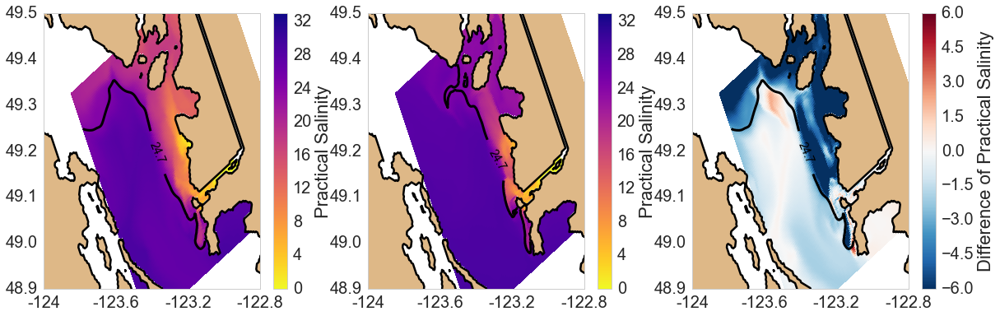

In [18]:
## Jan
for t in PET['jan']:
    Salinity(janall_T,jannof_T,t,t,'plasma_r',0)